## Notebook for going from the kwik files (kwd/kwe/kwik) to rasters
Uses:
    - intan2kwik (https://github.com/zekearneodo/intan2kwik/blob/master/README.md)
    - mountainlab suite(https://github.com/flatironinstitute/mountainlab-js)
    - mountainsort https://github.com/flatironinstitute/mountainsort_examples/blob/master/README.md
    - mountainsort examples https://github.com/flatironinstitute/mountainsort_examples/blob/master/README.md

In [1]:
import socket
import os
import glob
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from importlib import reload


import logging

# Setup the logger
logger = logging.getLogger()
logger.setLevel(logging.DEBUG)
formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')

ch = logging.StreamHandler()
ch.setLevel(logging.INFO)
ch.setFormatter(formatter)
logger.addHandler(ch)
        
logger.info('Logger set')
logger.info('Hostname {}'.format(socket.gethostname()))


from pipefinch.pipeline import rigutil
from pipefinch.pipeline import filestructure as et


from pipefinch.h5tools.kwik import kutil
from pipefinch.h5tools.kwik import event as ev

from pipefinch.h5tools.kwik import kwikfunctions as kwkf
from pipefinch.h5tools.kwik import kwdfunctions as kwdf

from pipefinch.neural.postsort import session

from pipefinch.pipeline import sglxutil as sglu

from pipefinch.neural import units as un


2019-08-20 18:21:21,990 - root - INFO - Logger set
2019-08-20 18:21:21,991 - root - INFO - Hostname zpikezorter


### Session parameters and raw files

In [2]:
# session parameters
sess_par = {'bird': 'g4r4',
           'sess': '20190715_02',
           'probe': 'probe_0', # probe to sort ('probe_0', 'probe_1') (to lookup in the rig_par which port to extract)
           'sort': 0, 
           'epoch': '20190715_02_dir_0-1', # for the subfolder in the neuropix data}
           }


# visualization default parameters
viz_par = { 'evt_name': 'motif',
           'evt_signal': 'trig_perceptron',
            'evt_edge': 1,
            'pre_ms': -500,
            'post_ms': 1500,
            
            'pre_samples': 0,
            'post_samples': 0,
            'span': 0,
           
           'break_raster_sample': 53731821, # where to introduce a break in the rasters bc undirected started
            }

exp_struct = sglu.sgl_struct(sess_par, sess_par['epoch'])

logger.info('Raw folder {}'.format(exp_struct['folders']['raw']))

kwik_folder = exp_struct['folders']['kwik']
kwd_path = exp_struct['files']['kwd']
exp_struct

2019-08-20 18:21:23,050 - root - INFO - Raw folder /mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/20190715_02_dir_0-1


{'folders': {'raw': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/20190715_02_dir_0-1',
  'kwik': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1',
  'msort': '/data/experiment/microdrive/g4r4/Ephys/msort/20190715_02/20190715_02_dir_0-1',
  'ksort': '/data/experiment/microdrive/g4r4/Ephys/ksort/20190715_02/20190715_02_dir_0-1'},
 'files': {'par': '/data/experiment/microdrive/g4r4/Ephys/ksort/20190715_02/20190715_02_dir_0-1/params.json',
  'set': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/settings.isf',
  'rig': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/rig.json',
  'kwd': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/stream.kwd',
  'kwik': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/sort_0/spikes.kwik',
  'kwe': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/events.kwe',
  'mda_raw': '/data/experiment/microdrive/g4r4/Ephys/msort/20190715_02/20190

In [3]:
kwd_path = exp_struct['files']['kwd']
reload(ev)
ttl = ev.TTL('ttl', 'DIN', kwd_path)
np.unique(ttl.event_pd['ch'])

array(['DIN-00', 'DIN-01', 'DIN-02'], dtype=object)

### instantiate a session object

In [4]:
reload(session)

<module 'pipefinch.neural.postsort.session' from '/home/ezequiel/repos/pipefinch/pipefinch/neural/postsort/session.py'>

In [5]:
sess = session.SglSession(sess_par, viz_par)
sess.load_rig_par()
sess.get_units_meta()
sess.get_event_ttl()
sess.load_mic_peri_event_streams()
sess.get_unit(16)
neur_arr = sess.get_perievent_neural_traces()

In [6]:
sess.rig_par['chan']['ttl']['trig_perceptron']

'DIN-02'

In [7]:
sess.s_f_neural

30000.0

In [8]:
units_pd = sess.units_meta_pd
units_pd.sort_values('main_chan', ascending=False, inplace=True)
units_pd.head()

,group,clu,qlt,tags,main_chans,accepted,mua,unsorted,main_chan
53,0,146,1,[mua],"[359, 357, 360, 358, 355, 356, 353, 354, 351, ...",False,True,False,359
52,0,145,2,[accepted],"[359, 357, 360, 358, 355, 356, 353, 354, 351, ...",True,False,False,359
51,0,144,1,[mua],"[355, 353, 357, 356, 354, 358, 351, 359, 352, ...",False,True,False,355
94,0,183,1,[mua],"[354, 352, 356, 353, 351, 355, 350, 358, 349, ...",False,True,False,354
91,0,180,2,[accepted],"[352, 350, 354, 351, 349, 353, 348, 356, 347, ...",True,False,False,352


In [9]:
sess.evt_ttl_pd.head()

,rec,ch_idx,t
edge,,,
1,0,2,274165
1,0,2,290565
1,0,2,299365
1,0,2,311845
1,0,2,324405


In [10]:
from pipefinch.neural import basic_plot as bp
reload(bp)
reload(session)
from pipefinch.util import spectral

In [11]:
viz_par['break_raster_sample']

53731821

In [12]:
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']>viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()
sess.evt_ttl_pd.tail()

,rec,ch_idx,t
edge,,,
1,0,2,51866090.0
1,0,2,51874730.0
1,0,2,51887530.0
1,0,2,51905690.0
1,0,2,51930091.0


/home/ezequiel/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/home/ezequiel/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1


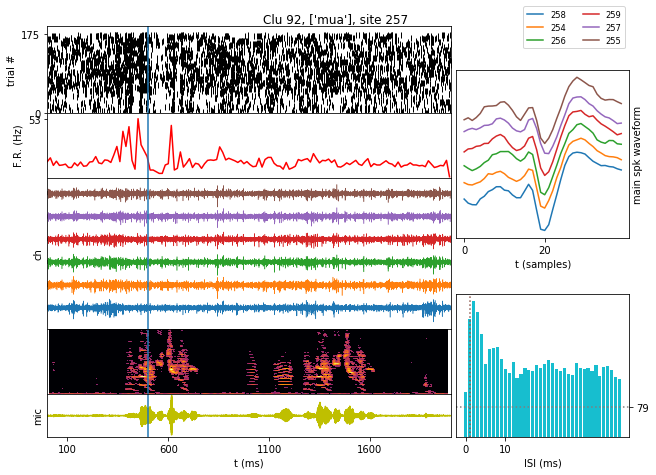

In [13]:
reload(session)
reload(bp)
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']>viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()
fig = session.plot_unit_sgl(sess, 92, example_event_id=7);

### Play with the neural traces

### get the waveforms of a unit

In [14]:
reload(un)
reload(sglu)
a_unit = un.SglUnit(16, sess.kwik_path, "", port=sess.probe_port)
#a_unit.get_unit_chans()

In [15]:
a_unit.get_waveforms(force=True)
main_wave = a_unit.get_unit_main_wave(n_chans=12)
main_chan_names = a_unit.get_unit_main_chans_names()

2019-08-20 18:22:35,002 - pipefinch.neural.units - INFO - Saving unit 16 in file /data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/sort_0/unit_waveforms/unit_0_016.npy
2019-08-20 18:22:35,007 - pipefinch.neural.units - INFO - Saving unit 16 in file /data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/sort_0/unit_waveforms/unit_0_016.npy


In [16]:
a_unit.get_max_amp_chans()

(array([ 5,  3,  1,  7,  6,  2,  9,  0,  4, 10,  8, 11]),
 array([ 0,  1,  6,  2,  3,  8,  7, 10,  4,  9,  5, 11]),
 array([53, 51, 48, 54, 46, 52, 55, 50, 49, 44, 47, 56], dtype=uint32),
 array(['053', '051', '048', '054', '046', '052', '055', '050', '049',
        '044', '047', '056'], dtype='<U3'))

In [17]:
chan_order, chan = a_unit.get_unit_main_chans(12)
chan_order

array([10,  6,  8,  1,  4,  0,  3,  2,  5,  7,  9, 11])

In [18]:
chan

array([50, 48, 52, 51, 49, 53, 46, 54, 47, 55, 44, 56], dtype=uint32)

In [19]:
chan[chan_order]

array([44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56], dtype=uint32)

In [20]:
main_chans_idx = a_unit.get_unit_main_chans(n_chans=8)[0]
main_chans_idx

array([6, 1, 4, 0, 3, 2, 5, 7])

In [21]:
main_wave.shape

(5000, 40, 12)

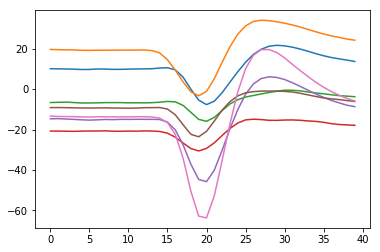

In [22]:
avg_wav = main_wave.mean(axis=0)
plt.plot(avg_wav[:, main_chans_idx[:7]])

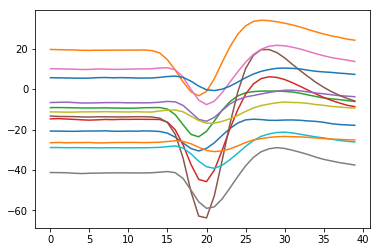

In [23]:
plt.plot(avg_wav)

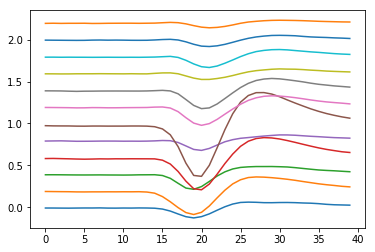

In [24]:
reload(bp)
avg_wav = main_wave.mean(axis=0)
bp.plot_array(avg_wav, scale='max', offset_scale=0.2)

In [26]:
spk_amps = np.ptp(avg_wav, axis=0)
spk_amps

array([0.18848334, 0.4485913 , 0.27180345, 0.62280259, 0.18478674,
       1.        , 0.35235232, 0.36041129, 0.12586947, 0.21459508,
       0.13347658, 0.09013166])

In [33]:
spk_amps_sort_ind = np.argsort(spk_amps, axis=0)[::-1]
spk_amps_sort_ind

array([ 5,  3,  1,  7,  6,  2,  9,  0,  4, 10,  8, 11])

In [34]:
spk_amps[spk_amps_sort_ind]

array([83.6542, 52.279 , 37.8948, 29.9752, 29.3638, 23.0534, 17.9158,
       15.918 , 15.6152, 11.3268, 10.637 ,  7.4274])

In [35]:
chan_amp_sorted = np.argsort(spk_amps, axis=0)[::-1]
chan_amp_sorted

array([ 5,  3,  1,  7,  6,  2,  9,  0,  4, 10,  8, 11])

In [36]:
np.max(np.ptp(avg_wav[:, chan_amp_sorted], axis=0))

83.6542

In [37]:
amp_avg_wav = avg_wav[:, chan_amp_sorted[:8]]

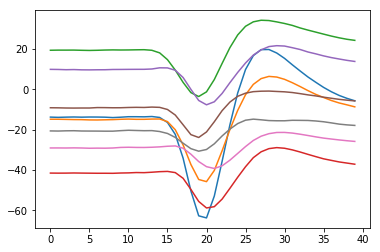

In [38]:
plt.plot(amp_avg_wav);

In [325]:
amp_avg_wav.shape

(40, 8)

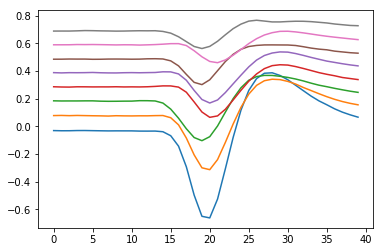

In [374]:
from pipefinch.neural import basic_plot as bp
reload(bp)

arr_plot = bp.plottable_array(amp_avg_wav,
                              np.ones(amp_avg_wav.shape[1]),
                              np.arange(amp_avg_wav.shape[1])*0.1)
plt.plot(arr_plot)

### Play with the neural traces

In [49]:
all_traces = sess.get_perievent_neural_traces()[5][:, chan_amp_sorted[:8]]
all_traces.shape



(59999, 8)

In [44]:
arr_plot = bp.plottable_array(all_traces,
                              np.ones(avg_wav.shape[1])/np.max(spk_amps),
                              np.arange(neural_filtered.shape[0]))

NameError: name 'neural_filtered' is not defined

In [138]:
##
# these should come from some meta file, of course
dtype = np.int16
n_chan_total = 385
##
raw_ap_path = sess.exp_struct['files']['bin_raw']
all_raw = np.memmap(raw_ap_path, dtype='int16', mode='r').reshape([-1, 385])
#all_raw.reshape([385, -1])
all_raw.shape

(116857939, 385)

In [139]:
a_unit.get_exp_struct()

{'folders': {'raw': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/20190715_02_dir_0-1',
  'kwik': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1',
  'msort': '/data/experiment/microdrive/g4r4/Ephys/msort/20190715_02/20190715_02_dir_0-1',
  'ksort': '/data/experiment/microdrive/g4r4/Ephys/ksort/20190715_02/20190715_02_dir_0-1'},
 'files': {'par': '/data/experiment/microdrive/g4r4/Ephys/ksort/20190715_02/20190715_02_dir_0-1/params.json',
  'set': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/settings.isf',
  'rig': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/rig.json',
  'kwd': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/stream.kwd',
  'kwik': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/sort_sort_0/spikes.kwik',
  'kwe': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_dir_0-1/events.kwe',
  'mda_raw': '/data/experiment/microdrive/g4r4/Ephys/msort/20190715_02/

In [140]:
a_unit.get_unit_main_chans()

(array([1, 0, 3, 2]), array([50, 48, 52, 51], dtype=uint32))

In [144]:
unit_wave = a_unit.get_waveforms(force=False)
#a_unit.waveforms

In [146]:
a_unit.get_unit_main_wave().shape


(5000, 40, 4)

In [147]:
a_unit.unit_chan_names[main_chans_idx]

array(['050', '048', '052', '051'], dtype='<U3')

In [148]:
a_unit.get_unit_chans()

array([50, 48, 52, 51, 49, 53, 46, 54, 47, 55, 44, 56], dtype=uint32)

In [149]:
a_unit.get_unit_main_chans()

(array([1, 0, 3, 2]), array([50, 48, 52, 51], dtype=uint32))

In [150]:
main_chans_idx = np.array([np.where(x==a_unit.get_unit_chans())[0] for x in a_unit.get_unit_main_chans()]).squeeze()
main_chans_idx

/home/ezequiel/anaconda3/envs/sort/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  """Entry point for launching an IPython kernel.


array([], shape=(2, 0), dtype=int64)

In [117]:
a_unit.get_unit_main_chans_names()

array(['050', '048', '052', '051'], dtype='<U3')

In [119]:
unit_wave = a_unit.get_waveforms(force=False)

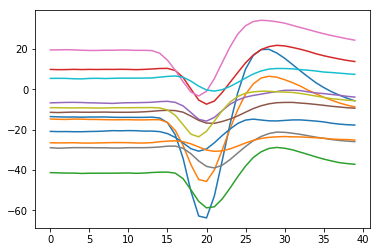

In [70]:
plt.plot(a_unit.all_waveforms.mean(axis=0));

In [120]:
a_unit.get_sort_pars()

{'kilo_version': 2,
 'n_filt': 1568,
 'filt_per_chan': 4,
 'auto_merge': 1,
 'use_gpu': 1,
 'port': 0,
 'n_chan': 385,
 's_f': 30000.0,
 'offset': 0,
 'hp_filtered': True,
 'dtype_name': 'int16'}

In [30]:
t_stamp

array([  747,  1355,  5820,  6437,  6959,  7990,  9957, 11601, 13467,
       14231, 14846, 15416, 16776, 17859, 20124, 21960, 23285, 24118,
       24854, 27842], dtype=uint64)

In [64]:
from pipefinch.util import jitarray as jita
reload(jita)
t_stamp = a_unit.get_time_stamps()[0][:50000] - 20
span = 40
chans = a_unit.get_unit_chans()
spikes = jita.collect_frames(all_raw, t_stamp, int(span), chans)
#spikes.shape

In [65]:
chans

array([50, 48, 52, 51, 49, 53, 46, 54, 47, 55, 44, 56], dtype=uint32)

In [66]:
spikes.shape

(50000, 40, 12)

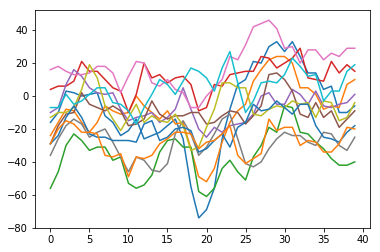

In [67]:
plt.plot(spikes[0]);

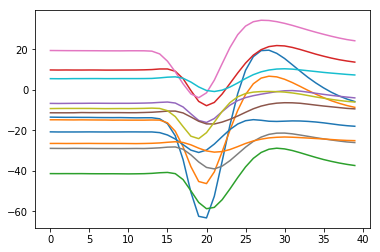

In [68]:
plt.plot(spikes.mean(axis=0));

In [63]:
a_unit.time_samples

array([      767,      1375,      5840, ..., 116853286, 116855587,
       116856576], dtype=uint64)

/home/ezequiel/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/home/ezequiel/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/home/ezequiel/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/home/ezequiel/anaconda3/envs/sort/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory

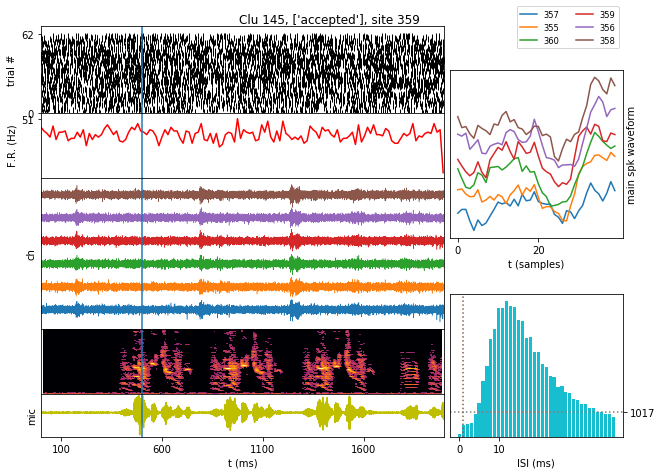

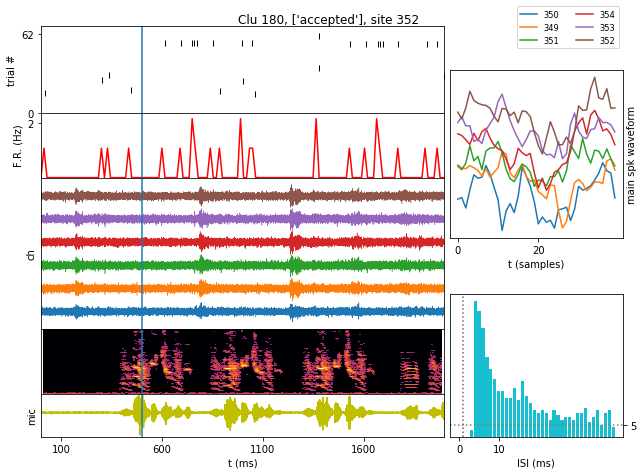

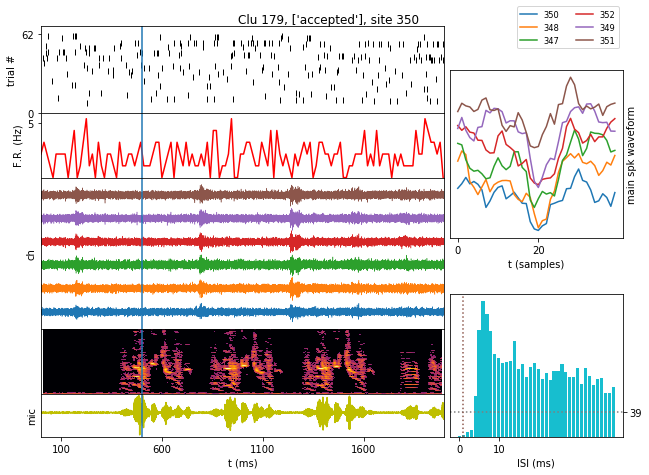

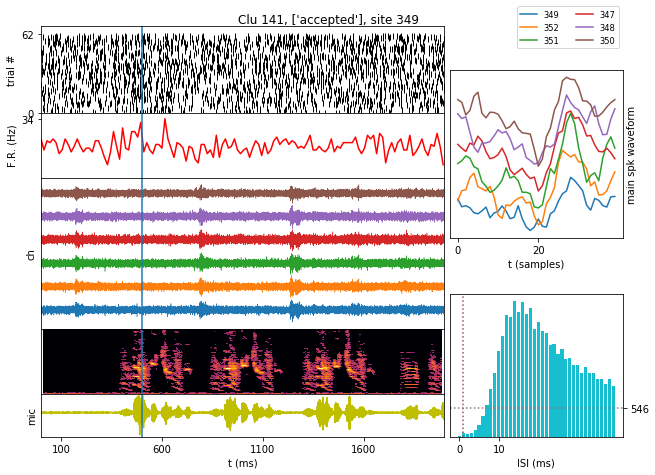

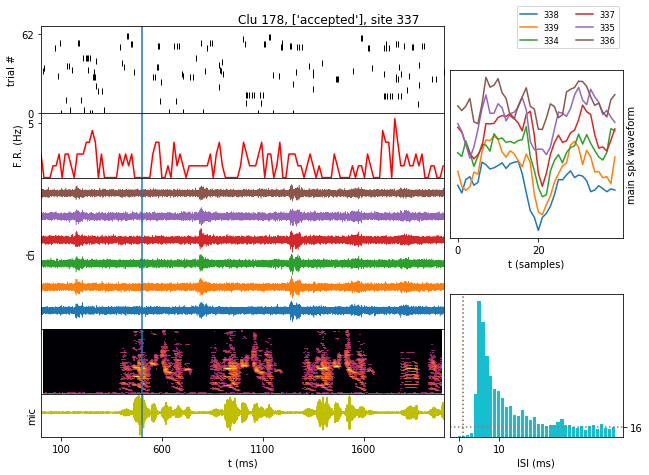

...

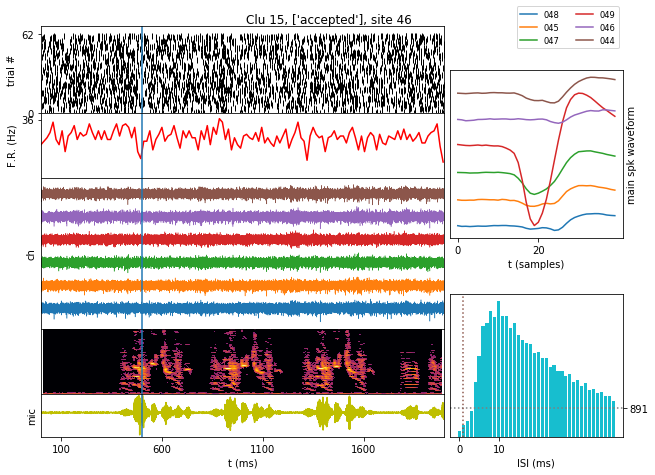

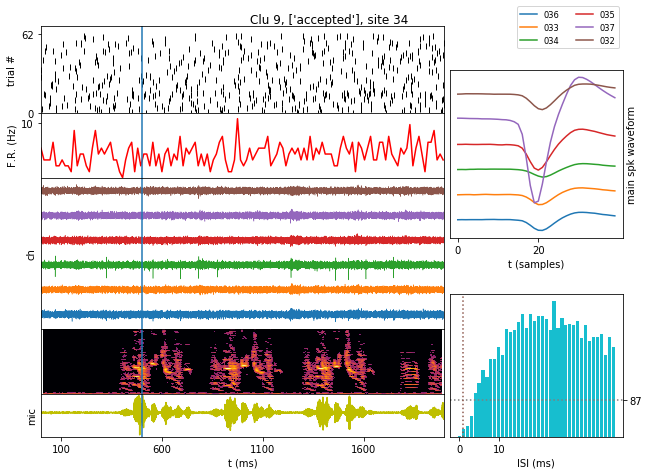

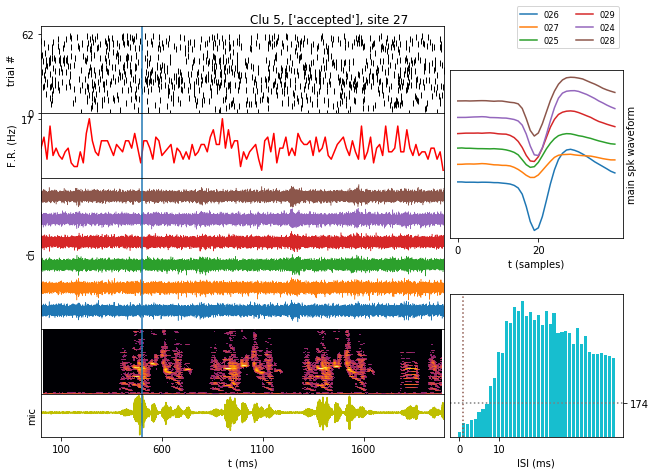

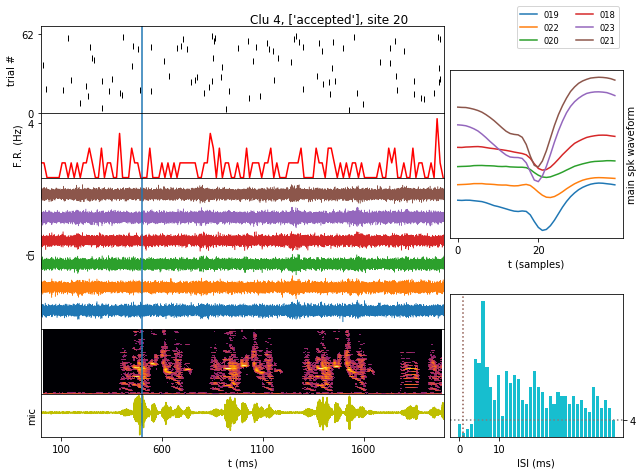

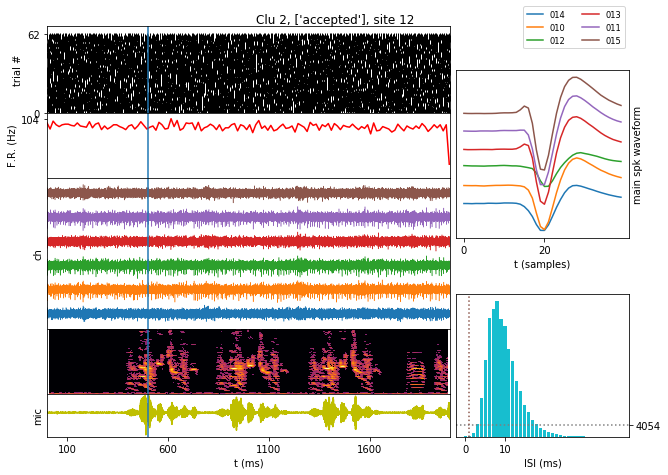

In [27]:
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']<viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()

for clu in units_pd[units_pd['qlt']==2]['clu']:
    try:
        session.plot_unit_sgl(sess, clu, example_event_id=41)
    except:
        logger.warning('Fail in clu {}'.format(clu))

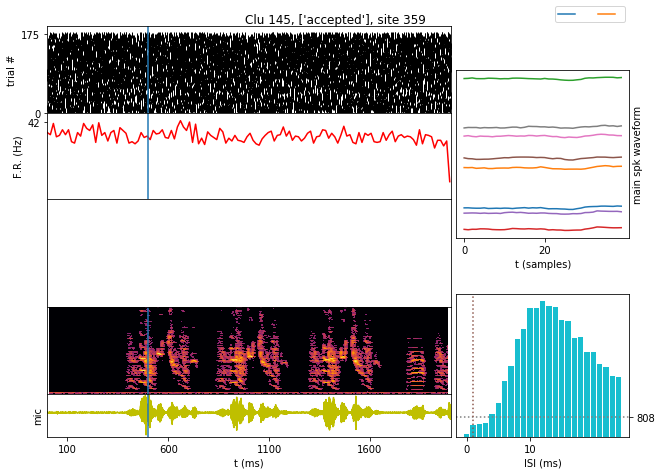

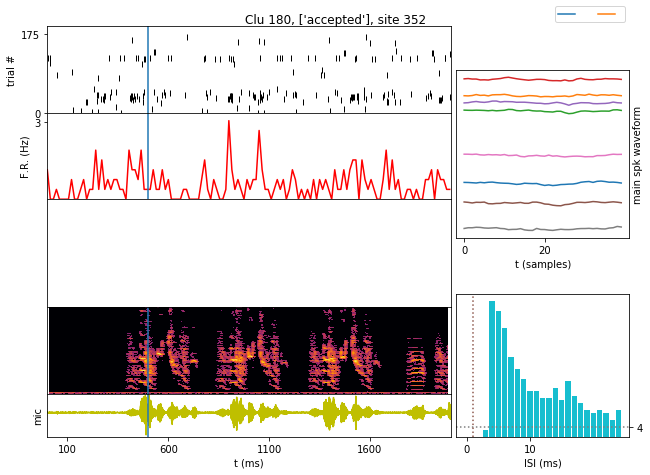

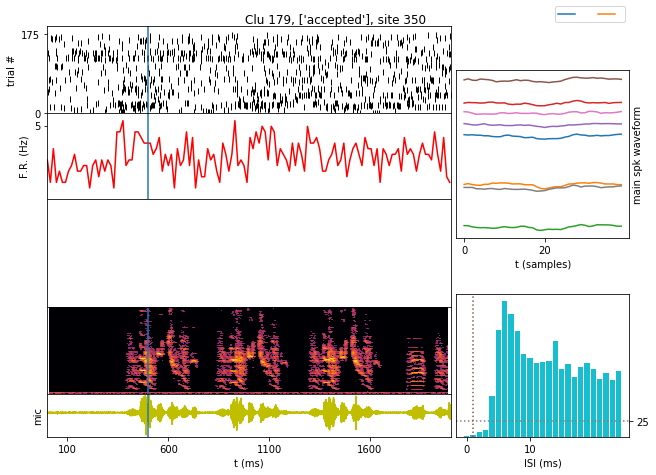

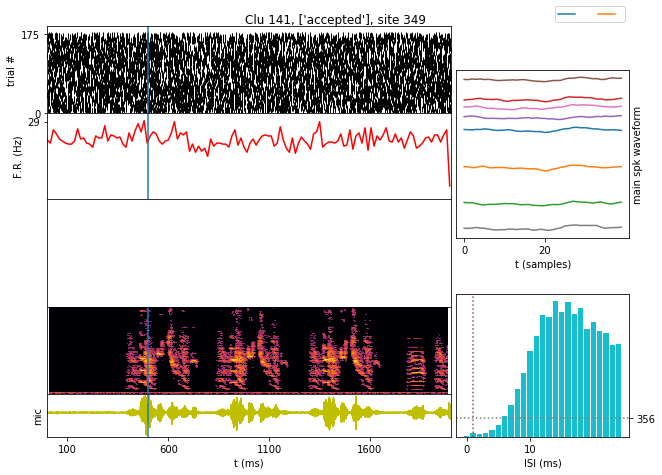

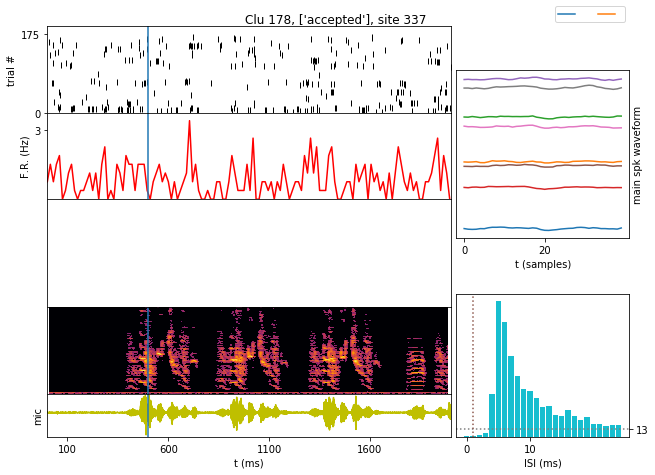

...

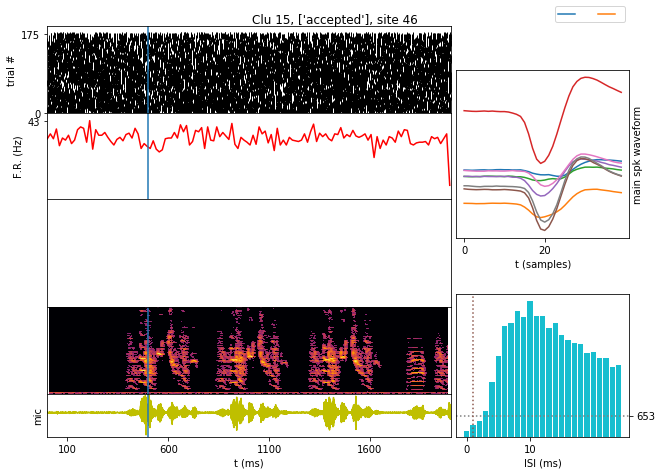

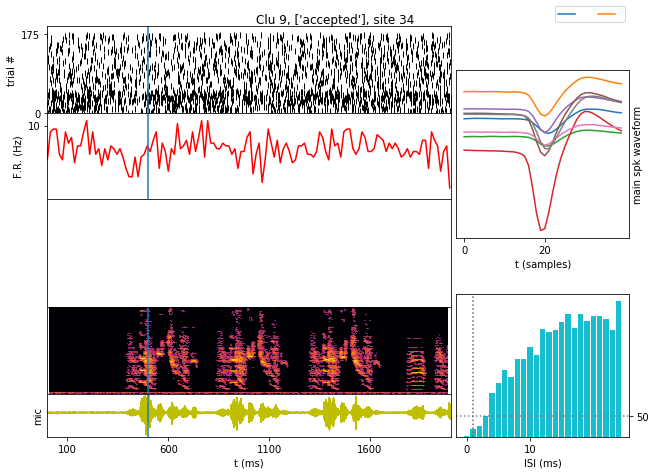

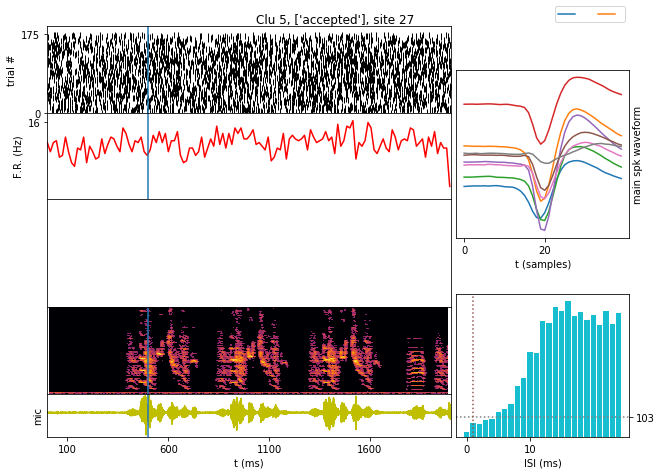

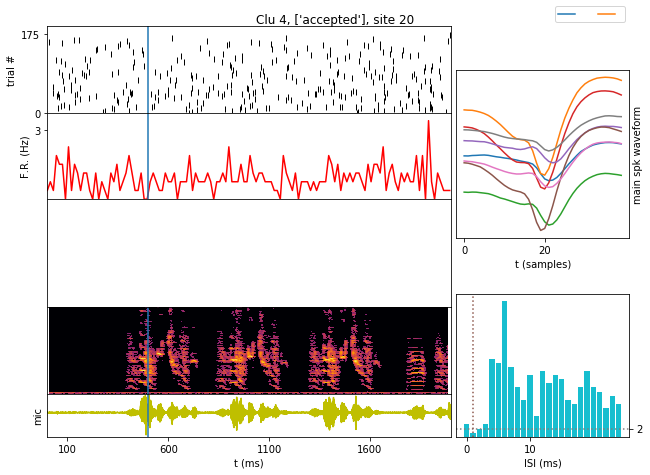

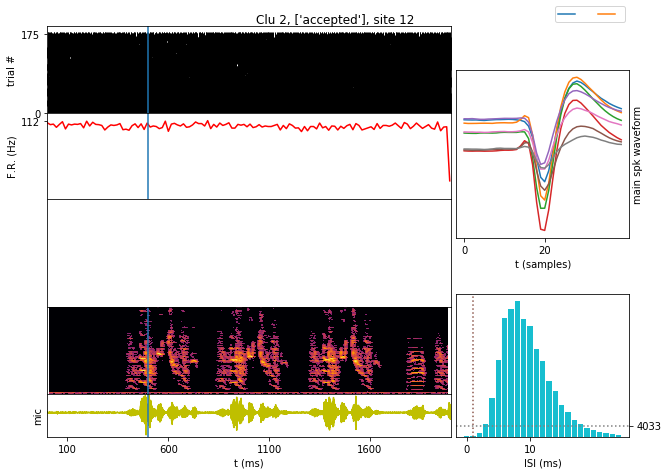

In [178]:
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']>viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()

for clu in units_pd[units_pd['qlt']==2]['clu']:
    try:
        session.plot_unit_sgl(sess, clu, example_event_id=41)
    except:
        logger.warning('Fail in clu {}'.format(clu))

In [122]:
# list of good clusters with song modulated activity (by visual inspection of the rasters)
good_modulated = [99, 89, 87, 86, 83, 81, 78, 76, 75, 73, 71, 49, 44, 43, 42, 40, 39, 38, 37, 35, 31, 188, 185, 18, 177, 170, 168, 169, 160, 157, 156, 154, 150, 111, 108]
len(good_modulated)

35

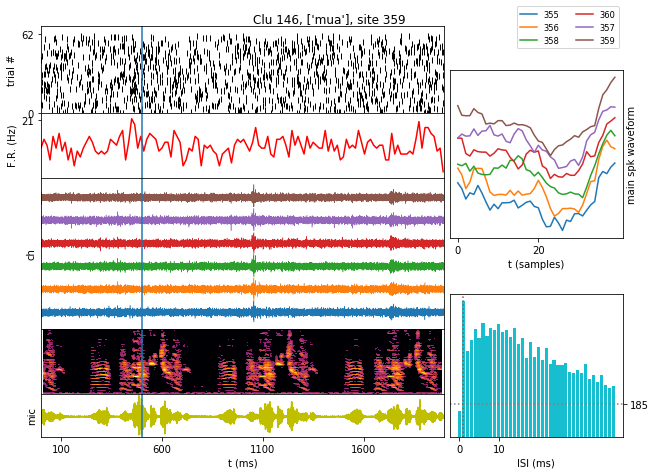

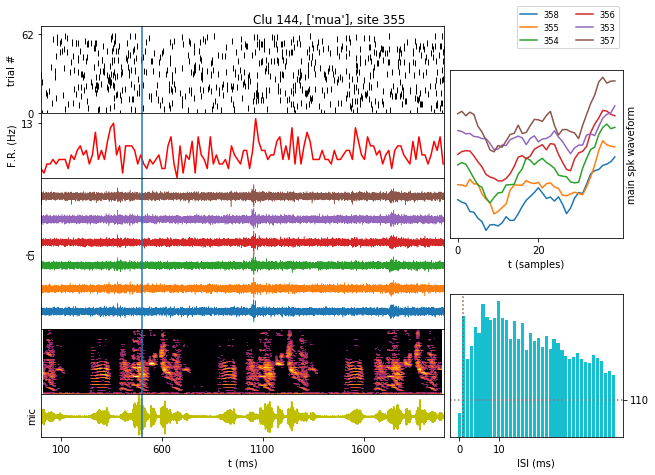

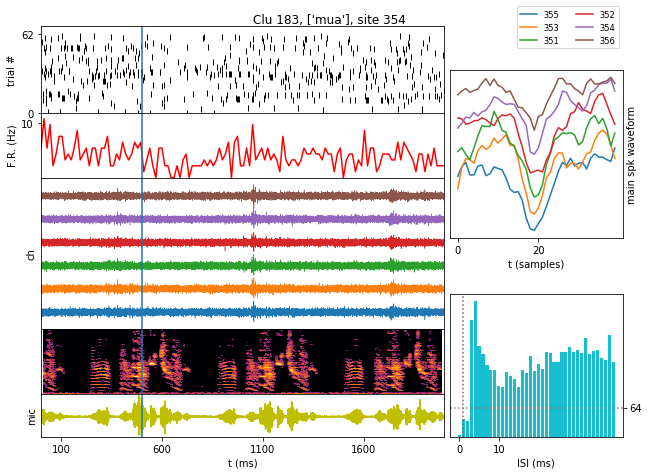

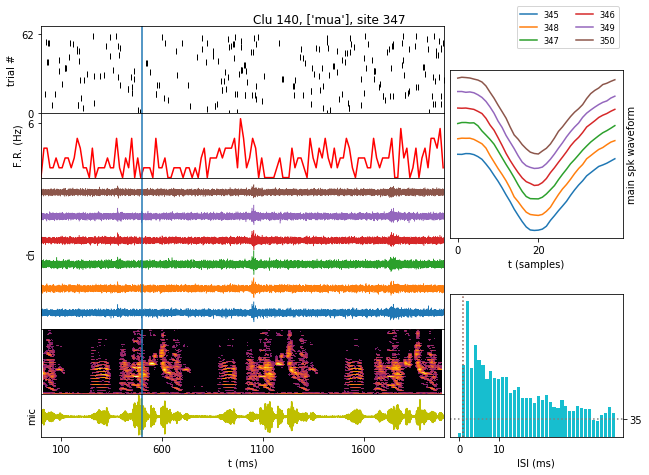

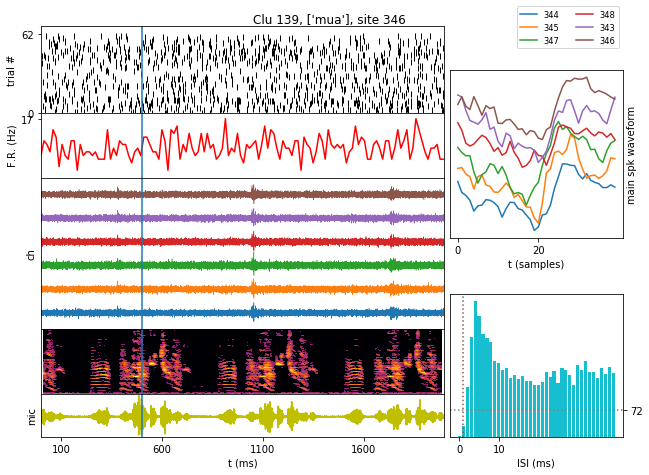

...

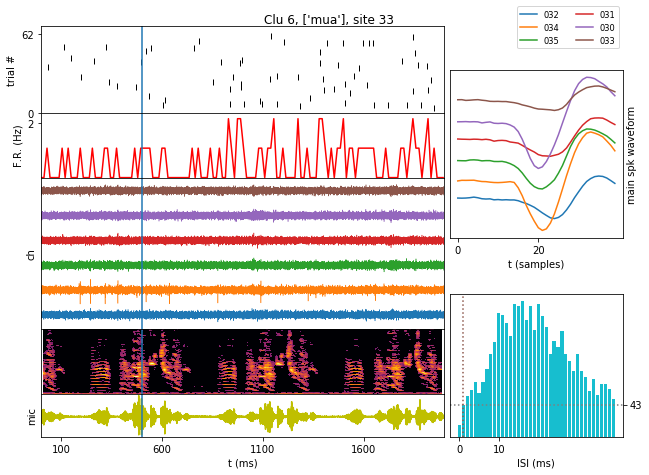

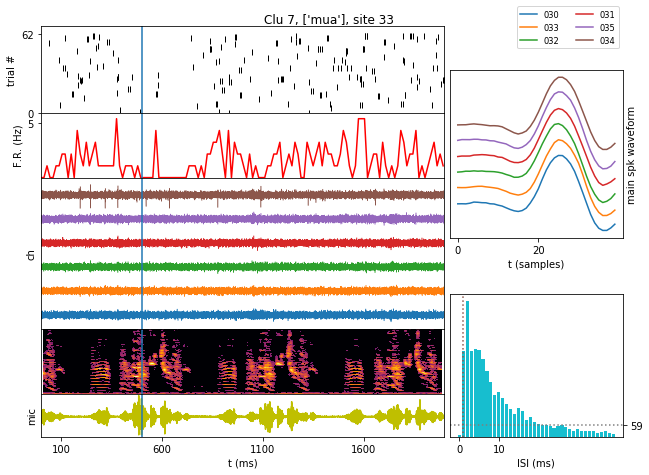

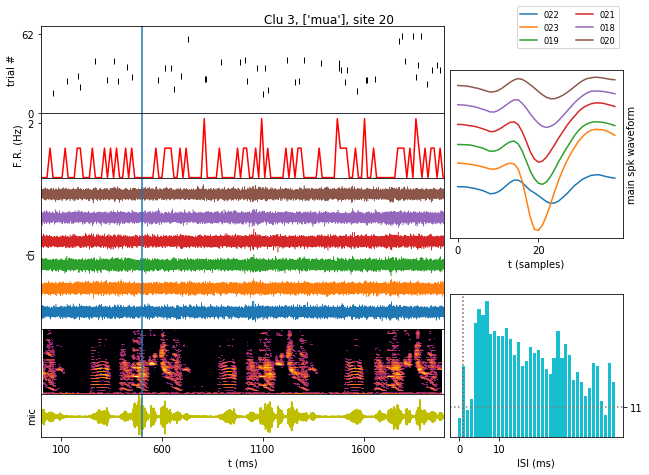

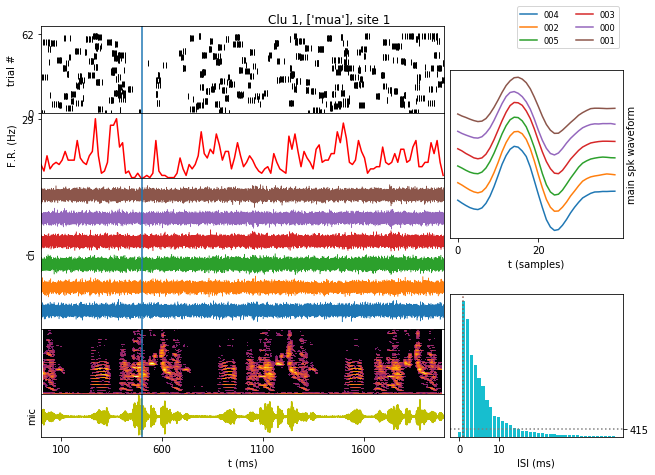

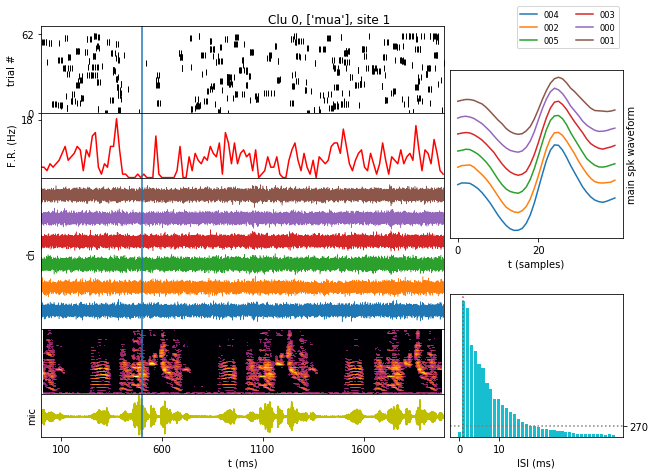

In [28]:
for clu in units_pd[units_pd['qlt']==1]['clu']:
    session.plot_unit_sgl(sess, clu, example_event_id=3)

In [123]:
mua_modulated = [101, 164, 165, 172, 187, 20, 22, 32, 36, 45, 60, 72, 74, 77, 80, 82, 95, 96]
len(mua_modulated)

18

In [115]:
reload(session)
session.plot_all_units(sess, only_tags = ['accepted', 'mua'], example_event_idx=3, raw_format='sgl')

KeyError: "Unable to open object (object 'data' doesn't exist)"

In [29]:
session

<module 'pipefinch.neural.postsort.session' from '/home/ezequiel/repos/pipefinch/pipefinch/neural/postsort/session.py'>

In [27]:
all_rec, all_start = sess.get_event_stamps()
all_start

array([  274165,   290565,   299365,   311845,   324405,   337125,
         349926,   413686,   431286,   450326,   462967,   551447,
         564567,  3637635,  3646435,  3655476,  3664996,  3676996,
        3689396,  3701876,  3728756,  3741396,  3803157,  3815797,
        3847237,  3877078,  7522151,  7536071,  7548631,  7561271,
        7582151,  7594711, 17850724, 17859204, 17868164, 17889924,
       17899524, 17911764, 17924244, 17937605, 17950565, 21686838,
       21695878, 21705079, 21717479, 21742839, 21752279, 21764679])

In [9]:
reload(units)

<module 'pipefinch.neural.units' from '/home/ezequiel/repos/pipefinch/pipefinch/neural/units.py'>

In [13]:
a_unit = units.Unit(29, sess.kwik_path, sess.kwd_path, port=sess.probe_port)
a_unit.get_time_stamps()
a_unit.get_attrs()
a_unit.get_unit_chan_names()
a_unit.get_unit_main_chans_names()

array(['A-013', 'A-010', 'A-015', 'A-011'], dtype='<U6')

In [54]:
sess.s_f

20000.19

# DEBUG VIEWING UNITS

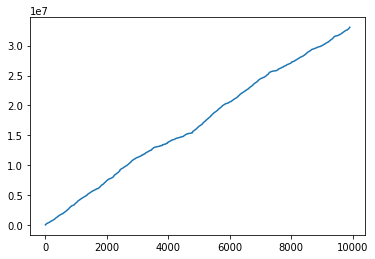

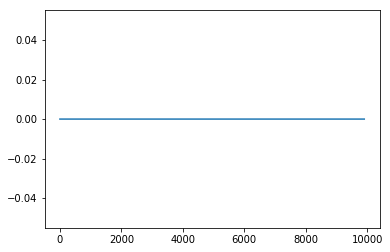

In [148]:
from pipefinch.neural import units
reload(kwdf)
reload(units)
reload(kwkf)

a_unit = units.SglUnit(10, sess.kwik_path, "")
t, r = a_unit.get_time_stamps()
#a_unit.get_unit_spikes()

plt.plot(t)
plt.figure()
plt.plot(r)

In [150]:
units.SglUnit(7, sess.kwik_path, '').get_unit_s

30

In [ ]:
sample = np.empty(0)
try:
    assert sample.size > 0, "no valid events"
except AssertionError as err:
    print(err.args)


In [ ]:
# get all unit waveforms in parallel
reload(units)
units.get_all_unit_waveforms(sess.kwik_path, sess.kwd_path)

In [ ]:
import h5py
kwkfile = h5py.File(sess.kwik_path, 'r')

r_path = "/channel_groups/0/spikes/recording"
clu_path = "/channel_groups/0/spikes/clusters/main"
t_path = '/channel_groups/0/spikes/time_samples'

recs = kwkfile[r_path][:]
clu = kwkfile[clu_path][:]
times = kwkfile[t_path][:]

In [ ]:
kwkfile.close()

In [ ]:
np.unique(recs)

In [ ]:
kwkfile['/channel_groups/0/spikes/clusters/main'][:]

In [ ]:
probe = {}
probe['a1x32-edge-5mm-20-177_H32'] = {i+1: (0, i*20) for i in range(32)}


# port_site maps
# each port is a dict {port: site}, where port is an int, site is an int
# port is

headstage = {}
headstage['intan-32-nn32'] = {23: 15, 22: 6, 21: 5, 20: 4, 19: 16, 18: 3, 17: 2, 16: 1,
                            15: 32, 14: 31, 13: 30, 12: 17, 11: 29, 10: 28, 9: 27, 8: 18,
                            24: 13, 25: 12, 26: 11, 27: 10, 28: 14, 29: 9, 30: 8, 31: 7,
                            0: 26, 1: 25, 2: 24, 3: 19, 4: 23, 5: 22, 6: 21, 7: 20}

def make_map(a_probe: dict, a_headstage: dict):
    # want to retrieve what coordinates are in each port of the headstage
    # headstage is {port: site}, probe is {site: coords}
    port_coords = {port: np.array(a_probe[site]) for port, site in sorted(a_headstage.items())}
    return (list(port_coords.values()))
    
np.vstack(make_map(probe['a1x32-edge-5mm-20-177_H32'], headstage['intan-32-nn32']))

In [ ]:
def site_port_map(probe_name: str, headstage_name: str):
    a_probe = probe[probe_name]
    a_headstage = headstage[headstage_name]

    return [h_port for site in a_probe.keys() for h_port, h_site in a_headstage.items() if h_site==site]

site_port_map('a1x32-edge-5mm-20-177_H32', 'intan-32-nn32')

In [23]:
import os